## Cleaning

### 1. Data preparation

#### Libraries import

In [1]:
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio

from scipy import stats

import numpy as np
import datetime

import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import seaborn as sns

from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

from IPython.display import Image
from pandasql import sqldf
import warnings
warnings.filterwarnings('ignore')

#### Data loading

In [2]:
raw_df = pd.read_csv('data/csv/fr.openfoodfacts.org.products.csv', sep='\t', low_memory=False)

#### Unification and aggregation

*This step is relevant if multiple datasets are gonna be used.  
The goal is to unify variable namings in order to merge all data having the same scope in a single dataset.*

**Only one dataset will be used here.**

#### Anonymization

*This step is relevant if Personal Identifiable Information (PII) is present in the dataset.  
If so, they should be deleted.*

**No PII is present in the dataset.**

#### Data review & variable selection

*The goal here is to get a very good grasp of what information the dataset contains, compared to the one necessary to the smooth execution of the project.  
Only variables relevant to the project should be kept, ideally relying on domain knowledge to make choices.*


In [3]:
print(raw_df.shape)

(320772, 162)


In [4]:
list(raw_df.columns)

['code',
 'url',
 'creator',
 'created_t',
 'created_datetime',
 'last_modified_t',
 'last_modified_datetime',
 'product_name',
 'generic_name',
 'quantity',
 'packaging',
 'packaging_tags',
 'brands',
 'brands_tags',
 'categories',
 'categories_tags',
 'categories_fr',
 'origins',
 'origins_tags',
 'manufacturing_places',
 'manufacturing_places_tags',
 'labels',
 'labels_tags',
 'labels_fr',
 'emb_codes',
 'emb_codes_tags',
 'first_packaging_code_geo',
 'cities',
 'cities_tags',
 'purchase_places',
 'stores',
 'countries',
 'countries_tags',
 'countries_fr',
 'ingredients_text',
 'allergens',
 'allergens_fr',
 'traces',
 'traces_tags',
 'traces_fr',
 'serving_size',
 'no_nutriments',
 'additives_n',
 'additives',
 'additives_tags',
 'additives_fr',
 'ingredients_from_palm_oil_n',
 'ingredients_from_palm_oil',
 'ingredients_from_palm_oil_tags',
 'ingredients_that_may_be_from_palm_oil_n',
 'ingredients_that_may_be_from_palm_oil',
 'ingredients_that_may_be_from_palm_oil_tags',
 'nutritio

In [5]:
# Remove variables with more than 60% missing values

missing_values = raw_df.isnull().sum()
missing_values_pct = missing_values / raw_df.shape[0] * 100
variables_60pct_null = (60 > missing_values_pct)

**Decision is made to keep only variables with less than 60% missing values**

In [6]:
df = raw_df.loc[:, variables_60pct_null]
list(df.columns)

['code',
 'url',
 'creator',
 'created_t',
 'created_datetime',
 'last_modified_t',
 'last_modified_datetime',
 'product_name',
 'brands',
 'brands_tags',
 'countries',
 'countries_tags',
 'countries_fr',
 'ingredients_text',
 'serving_size',
 'additives_n',
 'additives',
 'additives_tags',
 'additives_fr',
 'ingredients_from_palm_oil_n',
 'ingredients_that_may_be_from_palm_oil_n',
 'nutrition_grade_fr',
 'states',
 'states_tags',
 'states_fr',
 'energy_100g',
 'fat_100g',
 'saturated-fat_100g',
 'trans-fat_100g',
 'cholesterol_100g',
 'carbohydrates_100g',
 'sugars_100g',
 'fiber_100g',
 'proteins_100g',
 'salt_100g',
 'sodium_100g',
 'vitamin-a_100g',
 'vitamin-c_100g',
 'calcium_100g',
 'iron_100g',
 'nutrition-score-fr_100g',
 'nutrition-score-uk_100g']

In [7]:
df.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,brands,brands_tags,...,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin-a_100g,vitamin-c_100g,calcium_100g,iron_100g,nutrition-score-fr_100g,nutrition-score-uk_100g
0,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,Ferme t'y R'nao,ferme-t-y-r-nao,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,3.6,3.57,0.00000,0.000,0.0,0.0214,0.000,0.00129,14.0,14.0
2,0000000004559,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,Torn & Glasser,torn-glasser,...,7.1,17.86,0.63500,0.250,0.0,0.0000,0.071,0.00129,0.0,0.0
3,0000000016087,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,Grizzlies,grizzlies,...,7.1,17.86,1.22428,0.482,NaN,NaN,0.143,0.00514,12.0,12.0
4,0000000016094,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,Bob's Red Mill,bob-s-red-mill,...,5.7,8.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df.shape

(320772, 42)

**Non-domain related columns are dropped**

In [9]:
columns_to_drop = ['code',
                   'url',
                   'creator',
                   'created_datetime',
                   'last_modified_t',
                   'last_modified_datetime',
                   'image_url',
                   'image_small_url',
                   'tags'
                  ]

columns_to_drop = '|'.join(columns_to_drop)
columns_to_drop = df.filter(regex=columns_to_drop, axis=1)
df = df.drop(columns_to_drop.columns, axis=1)

In [10]:
df.shape

(320772, 32)

In [11]:
df.columns

Index(['created_t', 'product_name', 'brands', 'countries', 'countries_fr',
       'ingredients_text', 'serving_size', 'additives_n', 'additives',
       'additives_fr', 'ingredients_from_palm_oil_n',
       'ingredients_that_may_be_from_palm_oil_n', 'nutrition_grade_fr',
       'states', 'states_fr', 'energy_100g', 'fat_100g', 'saturated-fat_100g',
       'trans-fat_100g', 'cholesterol_100g', 'carbohydrates_100g',
       'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g',
       'sodium_100g', 'vitamin-a_100g', 'vitamin-c_100g', 'calcium_100g',
       'iron_100g', 'nutrition-score-fr_100g', 'nutrition-score-uk_100g'],
      dtype='object')

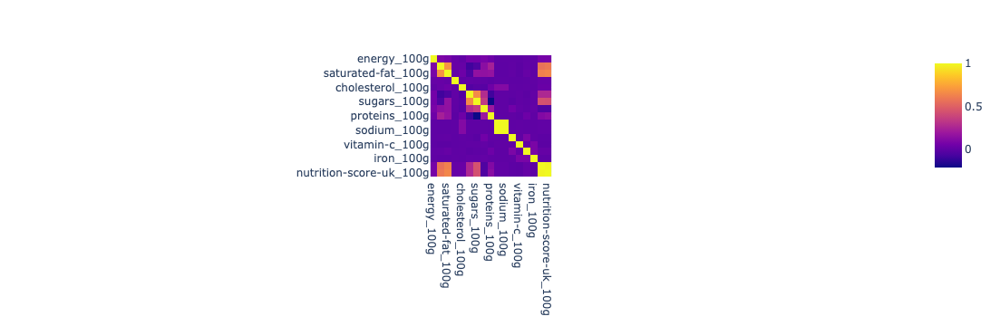

In [12]:
# Checking correlation for nutritional values
mask = df.columns.str.contains('100g')
corr_matrix = df.loc[:, mask].corr()
heatmap = px.imshow(corr_matrix)
heatmap.show()

**Interesting correlation between the variables used for Nutriscore calculation.** 

Based on what I observed in the dataset until now, I decide to focus my application on the Nutriscore. 

That's why decided to keep 3 types of variables for my upcoming cleaning & analysis:
* Product-related variables
* Nutritional values part of the formula to calculate Nutriscore.
* Nutriscore.

In [13]:
relevant_variables = ['product_name',
                      'brands',
                      'countries_fr',
                      'created_t',
                      'energy_100g',
                      'fat_100g',
                      'saturated-fat_100g',
                      'sugars_100g',
                      'fiber_100g',
                      'proteins_100g',
                      'salt_100g',
                      'sodium_100g',
                      'nutrition-score-fr_100g'
                     ]

# Adding back fruits, vegetables & nuts per 100g even though they have >80% missing values, as it's part of the Nutriscore
df = df[relevant_variables].merge(raw_df['fruits-vegetables-nuts_100g'], left_index=True, right_index=True)

In [14]:
# Proper naming to facilitate multi-variable treatments
df.rename(columns={
    'nutrition-score-fr_100g': 'nutriscore',
    'energy_100g': 'energy_kj',
    }, inplace=True)

In [15]:
df.shape

(320772, 14)

In [16]:
list(df.columns)

['product_name',
 'brands',
 'countries_fr',
 'created_t',
 'energy_kj',
 'fat_100g',
 'saturated-fat_100g',
 'sugars_100g',
 'fiber_100g',
 'proteins_100g',
 'salt_100g',
 'sodium_100g',
 'nutriscore',
 'fruits-vegetables-nuts_100g']

#### Data dictionary

*The data dictionary will contain all the metadata and validity constraints established regarding the picked relevant variables.*

In [17]:
data_dict = pd.read_json('cleaning/data_dict.json')
data_dict

,variable,exact_name,description,dtype,values_range,possible_values,nullable,unique,unique_combinations,regex
0,product_name,True,Name of the product,string,[],[],True,False,"[product_name, brand]",
1,brands,True,Name of the brand,string,[],[],True,False,"[product_name, brand]",
2,countries_fr,True,Name of the country of origin,string,[],[],True,False,[],
3,100g,False,Nutritional values,float64,"[0.0, 100.0]",[],True,False,[],


### 2. Data inspection

*This step identifies all the data quality errors and constraints violations, that will need to be cleaned in the upcoming treatments.  
Every required cleaning is documented in the cleaning plan with its associated treatment (available in project folder, cleaning/cleaning_plan.txt)*

**First high-level inspection**

In [18]:
df.describe()

,energy_kj,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore,fruits-vegetables-nuts_100g
count,2.611130e+05,243891.000000,229554.000000,244971.000000,200886.000000,259922.000000,255510.000000,255463.000000,221210.000000,3036.000000
mean,1.141915e+03,12.730379,5.129932,16.003484,2.862111,7.075940,2.028624,0.798815,9.165535,31.458587
std,6.447154e+03,17.578747,8.014238,22.327284,12.867578,8.409054,128.269454,50.504428,9.055903,31.967918
min,0.000000e+00,0.000000,0.000000,-17.860000,-6.700000,-800.000000,0.000000,0.000000,-15.000000,0.000000
25%,3.770000e+02,0.000000,0.000000,1.300000,0.000000,0.700000,0.063500,0.025000,1.000000,0.000000
50%,1.100000e+03,5.000000,1.790000,5.710000,1.500000,4.760000,0.581660,0.229000,10.000000,23.000000
75%,1.674000e+03,20.000000,7.140000,24.000000,3.600000,10.000000,1.374140,0.541000,16.000000,51.000000
max,3.251373e+06,714.290000,550.000000,3520.000000,5380.000000,430.000000,64312.800000,25320.000000,40.000000,100.000000


In [19]:
# Check if there are no data type constraints violation

df.dtypes

product_name                    object
brands                          object
countries_fr                    object
created_t                       object
energy_kj                      float64
fat_100g                       float64
saturated-fat_100g             float64
sugars_100g                    float64
fiber_100g                     float64
proteins_100g                  float64
salt_100g                      float64
sodium_100g                    float64
nutriscore                     float64
fruits-vegetables-nuts_100g    float64
dtype: object

In [20]:
# Check for full duplicates

df.duplicated(keep=False).sum()

2968

**Product-related qualitative variables inspection**

In [21]:
# Check for non-Unix timestamps values to convert created_t into datetime

mask_unix_timestamps = df['created_t'].str.contains(r'^\d+$').fillna(False)

df.loc[~mask_unix_timestamps].shape[0]

23

In [22]:
# Check for completeness and uniqueness %

for variable in data_dict['variable'].loc[data_dict['exact_name']]:
    null_n = df[variable].isnull().sum()
    null_pct = round(null_n / len(df) * 100, 2)
    unique_n = df[variable].nunique()
    unique_pct = round(unique_n / len(df) * 100, 2)
    print(variable, "Null:", str(null_n), str(null_pct) + "%")
    print(variable, "Unique:", str(unique_n), str(unique_pct) + "%")

product_name Null: 17762 5.54%
product_name Unique: 221347 69.0%
brands Null: 28412 8.86%
brands Unique: 58784 18.33%
countries_fr Null: 280 0.09%
countries_fr Unique: 722 0.23%


In [23]:
# Check for unique countries values as n (722) is anormal

df['countries_fr'].unique()

# Values with multiple countries + inconsistent typographies have been identified

array(['France', 'États-Unis', 'Royaume-Uni', 'France,États-Unis',
       'Canada', 'Suisse', 'Espagne', 'Allemagne', 'Slovénie', 'Italie',
       'Roumanie', 'Australie', 'Portugal', 'France,Royaume-Uni',
       'Belgique,France,Pays-Bas,Royaume-Uni', 'Guadeloupe', nan,
       'Royaume-Uni,États-Unis', 'Canada,États-Unis', 'Pays-Bas',
       'Australie,France', 'Canada,France,Suisse,États-Unis',
       'France,États-Unis,en:Etats-unis', 'Irlande', 'France,La Réunion',
       'Taiwan', 'Australie,Suisse', 'France,Allemagne', 'Brésil',
       'Belgique,France', 'République dominicaine',
       'États-Unis,en:Australie', 'Arabie saoudite',
       'Émirats arabes unis', 'Irak', 'Koweït', 'Moldavie', 'Belgique',
       'Nouvelle-Calédonie', 'Singapour', 'Finlande',
       'Australie,États-Unis', 'France,Suisse',
       'Australie,Nouvelle-Zélande,Singapour,Thaïlande,États-Unis',
       'Polynésie française', 'Panama', 'Costa Rica', 'Mexique',
       'États-Unis,en:Pays-bas', 'Espagne,Royau

In [24]:
# Check for the relative size of data points containing multiple countries

mask_multiple_countries = df['countries_fr'].str.contains(",").fillna(False)
mask_multiple_countries.sum() / len(df) * 100

1.5765091716234585

In [25]:
# Check for the relative size of data points containing inconsistent typos

mask_weird_typos = (df['countries_fr'].str.contains(r'^en:').fillna(False)) | (df['countries_fr'].str.contains('Other'))
mask_weird_typos.sum() / len(df) * 100

0.025563328470065965

In [26]:
df.loc[~(mask_multiple_countries) & ~(mask_weird_typos), :].shape[0]

315646

In [27]:
# Check for duplicates among products

mask_duplicated_products = df[['product_name', 'brands']].duplicated(keep=False)
mask_duplicated_products.sum()

51427

**Quantitative nutritional variables inspection**

In [28]:
# Check for anormal outliers among grams per 100g variables

out_of_range_total = 0

for variable in df.filter(like='100g'):
    mask = (df[variable] > 100.0) | (df[variable] < 0.0)
    out_of_range_n = mask.sum()
    out_of_range_pct = round(out_of_range_n / len(df) * 100, 2)
    out_of_range_total += out_of_range_n
    print(variable)
    print("Out of range:", str(out_of_range_n), "data points,", str(out_of_range_pct) + "%\n")

mask = df['fat_100g'] + df['saturated-fat_100g'] + df['sugars_100g'] + df['fiber_100g'] + df['proteins_100g'] + df['salt_100g'] + df['sodium_100g'] + df['fruits-vegetables-nuts_100g'] > 100

out_of_range_total += df.loc[mask].shape[0]


print("Total anormal outlier values:", out_of_range_total)

fat_100g
Out of range: 4 data points, 0.0%

saturated-fat_100g
Out of range: 3 data points, 0.0%

sugars_100g
Out of range: 19 data points, 0.01%

fiber_100g
Out of range: 5 data points, 0.0%

proteins_100g
Out of range: 4 data points, 0.0%

salt_100g
Out of range: 158 data points, 0.05%

sodium_100g
Out of range: 34 data points, 0.01%

fruits-vegetables-nuts_100g
Out of range: 0 data points, 0.0%

Total anormal outlier values: 662


In [29]:
# Check for anormal outliers for energy expenditure

variable = 'energy_kj'
mask = (df[variable] < 0) | (df[variable] > 3800)
out_of_range_n = mask.sum()
out_of_range_pct = round(out_of_range_n / len(df) * 100, 2)
print(variable, "Out of range:", str(out_of_range_n), str(out_of_range_pct) + "%")

energy_kj Out of range: 357 0.11%


In [30]:
stats.zscore(df['energy_kj'].notnull()).sort_values()

0        -2.092070
249986   -2.092070
249987   -2.092070
249988   -2.092070
249989   -2.092070
            ...   
108011    0.477995
108010    0.477995
108009    0.477995
108016    0.477995
320771    0.477995
Name: energy_kj, Length: 320772, dtype: float64

In [31]:
# Check for completeness  %

for variable in pd.merge(df.filter(like='100g'), df[['energy_kj']], left_index=True, right_index=True):
    null_n = df[variable].isnull().sum()
    null_pct = round(null_n / len(df) * 100, 2)
    print(variable)
    print("Null:", str(null_n), "data points", str(null_pct) + "%", "\n")

fat_100g
Null: 76881 data points 23.97% 

saturated-fat_100g
Null: 91218 data points 28.44% 

sugars_100g
Null: 75801 data points 23.63% 

fiber_100g
Null: 119886 data points 37.37% 

proteins_100g
Null: 60850 data points 18.97% 

salt_100g
Null: 65262 data points 20.35% 

sodium_100g
Null: 65309 data points 20.36% 

fruits-vegetables-nuts_100g
Null: 317736 data points 99.05% 

energy_kj
Null: 59659 data points 18.6% 



In [32]:
# Check for data points with no nutritional information at all
no_nutritional_info_mask = (df['fat_100g'].isnull()) & (df['saturated-fat_100g'].isnull()) & (df['sugars_100g'].isnull()) & (df['proteins_100g'].isnull()) & (df['salt_100g'].isnull()) & (df['sodium_100g'].isnull())
df.loc[no_nutritional_info_mask].shape[0]

58650

**Nutriscore inspection**

In [33]:
df['nutriscore'].isnull().sum() / len(df) * 100

31.038245233374482

In [34]:
stats.zscore(df['nutriscore'].notnull()).sort_values()

0        -1.490581
192206   -1.490581
192207   -1.490581
192211   -1.490581
192212   -1.490581
            ...   
162640    0.670879
162641    0.670879
162642    0.670879
162616    0.670879
201025    0.670879
Name: nutriscore, Length: 320772, dtype: float64

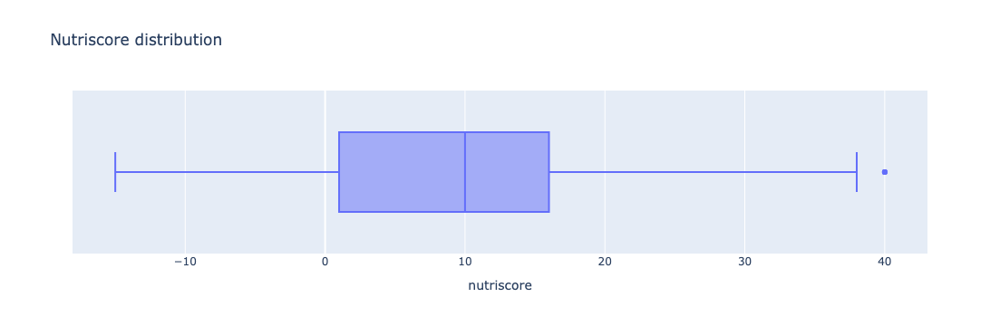

In [35]:
fig = px.box(df, x="nutriscore", title="Nutriscore distribution")
fig.show()

### 3. Data cleaning

In [36]:
# Convert created_t to datetime

df = df.loc[(mask_unix_timestamps) & ~(df['created_t'] == '0')]
df.shape

df['created_t'] = pd.to_datetime(df['created_t'], unit='s')

In [37]:
# Remove full duplicates

df = df.loc[~df.duplicated()]

In [38]:
# Remove product duplicates by keeping most recent values

df.sort_values('created_t', ascending=False, inplace=True)
df.drop_duplicates(subset=['product_name', 'brands'], keep='first', inplace=True)
print(df.shape[0])

283627


In [39]:
# Remove anomalies in countries_fr
df = df.loc[~((mask_weird_typos) | (mask_multiple_countries))]
df.shape

(279131, 14)

In [40]:
# Remove anormal outliers for nutritional values

# 100g variables
for variable in df.filter(like='100g'):
    mask = ((df[variable] > 100.0) | (df[variable] < 0.0) | (df['fat_100g'] + df['saturated-fat_100g'] + df['sugars_100g'] + df['fiber_100g'] + df['proteins_100g'] + df['salt_100g'] + df['sodium_100g'] + df['fruits-vegetables-nuts_100g'] > 100)) 
    df = df.loc[~mask]

# Fat variables
mask = (df['saturated-fat_100g'] >  df['fat_100g'])
df = df.loc[~mask]

# Calories
mask = ((df['energy_kj'] < 0) | (df['energy_kj'] > 3800))
df = df.loc[~mask]

In [41]:
# Remove data points with no nutritional values

df = df.loc[~(no_nutritional_info_mask)]

In [42]:
# Impute missing values in nutritional values using KNNImputer

columns_to_impute = ['fat_100g', 'saturated-fat_100g', 'salt_100g', 'sodium_100g', 'proteins_100g', 'sugars_100g', 'fiber_100g']


imputer = KNNImputer(n_neighbors=4)
df_to_impute = df[columns_to_impute]

scaler = MinMaxScaler()
df_to_impute = pd.DataFrame(scaler.fit_transform(df_to_impute), columns=df_to_impute.columns)

df_sample = df_to_impute.sample(10000)
imputer.fit(df_sample)

df_imputed_array = imputer.transform(df_to_impute)
df_imputed = pd.DataFrame(df_imputed_array, columns=columns_to_impute)

df_imputed = pd.DataFrame(scaler.inverse_transform(df_imputed), columns=columns_to_impute)
df_imputed.index = df.index
df[columns_to_impute] = df_imputed

In [43]:
# Train regression model to impute energy missing values
df_regression = df.loc[df['energy_kj'].isnull() == False]

df_x = df_regression[columns_to_impute]
df_y = df_regression['energy_kj']

reg = LinearRegression()
X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size=0.2, random_state=42)
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)
mae =  mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("MAE =", mae, "R2 =", r2)

MAE = 310.30337146060333 R2 = 0.7241996716281558


In [44]:
# Impute energy missing values
df_to_impute = df.loc[df['energy_kj'].isnull()]
df_x = df_to_impute[columns_to_impute]

y_pred = reg.predict(df_x)
df.loc[df['energy_kj'].isnull(), 'energy_kj'] = y_pred

In [45]:
# Train regression model to impute nutriscore missing values
df_regression = df.loc[df['nutriscore'].isnull() == False]
df_x = df_regression[columns_to_impute]
df_y = df_regression['nutriscore']

reg = LinearRegression()
X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size=0.2, random_state=42)
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)
mae =  mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("MAE =", mae, "R2 =", r2)

MAE = 4.001078226736329 R2 = 0.6848953954086403


In [46]:
# Impute nutriscore missing values
df_to_impute = df.loc[df['nutriscore'].isnull()]
df_x = df_to_impute[columns_to_impute]

y_pred = reg.predict(df_x)
df.loc[df['nutriscore'].isnull(), 'nutriscore'] = y_pred

In [47]:
# Replace fruits_vegetables_nuts_100g with 0s

df['fruits-vegetables-nuts_100g'] = 0

In [48]:
# Convert kilojoules to calories

df['energy_kj'] = df['energy_kj'] * 0.239
df.rename(columns={'energy_kj' : 'calories'}, inplace=True)

In [49]:
# Remove new outliers from regressions

# Calories
mask = ((df['calories'] < 0) | (df['calories'] > 900))
df = df.loc[~mask]

# Nutriscore
mask = ((df['nutriscore'] < -15) | (df['nutriscore'] > 40))
df = df.loc[~mask]

In [50]:
query = """
SELECT *,
CASE
WHEN ROUND(nutriscore) BETWEEN -15 AND -2 THEN 'A'
WHEN ROUND(nutriscore) BETWEEN -1 AND 3 THEN 'B'
WHEN ROUND(nutriscore) BETWEEN 4 AND 11 THEN 'C'
WHEN ROUND(nutriscore) BETWEEN 12 AND 16 THEN 'D'
WHEN ROUND(nutriscore) BETWEEN 17 AND 40 THEN 'E'
ELSE NULL
END as nutriscore_label
FROM df
"""

df = sqldf(query)
# Convert date back to datetime
df['created_t'] = pd.to_datetime(df['created_t'])

### 4. Evaluation

In [51]:
df.shape

(234097, 15)

In [52]:
df.isnull().sum()

product_name                    373
brands                         2788
countries_fr                     60
created_t                         0
calories                          0
fat_100g                          0
saturated-fat_100g                0
sugars_100g                       0
fiber_100g                        0
proteins_100g                     0
salt_100g                         0
sodium_100g                       0
nutriscore                        0
fruits-vegetables-nuts_100g       0
nutriscore_label                  0
dtype: int64

## Analysis

### Univariate analysis

In [53]:
df.describe()

,created_t,calories,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore,fruits-vegetables-nuts_100g
count,234097,234097.000000,234097.000000,234097.000000,234097.000000,234097.000000,234097.000000,234097.000000,234097.000000,234097.000000,234097.0
mean,2016-09-28 11:38:45.937777664,268.171876,12.223407,4.560486,15.877558,2.499332,7.160885,1.469549,0.578596,9.150253,0.0
min,2012-01-31 14:43:12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000,0.0
25%,2017-01-26 16:34:08,93.210000,0.000000,0.000000,1.500000,0.000000,0.790000,0.070000,0.027559,1.375885,0.0
50%,2017-03-09 13:17:52,264.095000,5.130000,1.250000,6.250000,1.175000,4.900000,0.600000,0.236220,9.000000,0.0
75%,2017-03-09 20:30:56,400.086000,19.470000,6.670000,24.000000,3.325000,10.200000,1.381760,0.544000,16.000000,0.0
max,2017-04-20 21:13:36,899.596000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,39.370079,40.000000,0.0
std,NaN,186.586710,16.539407,7.281471,20.630796,4.189305,8.136368,5.134544,2.021460,8.958253,0.0


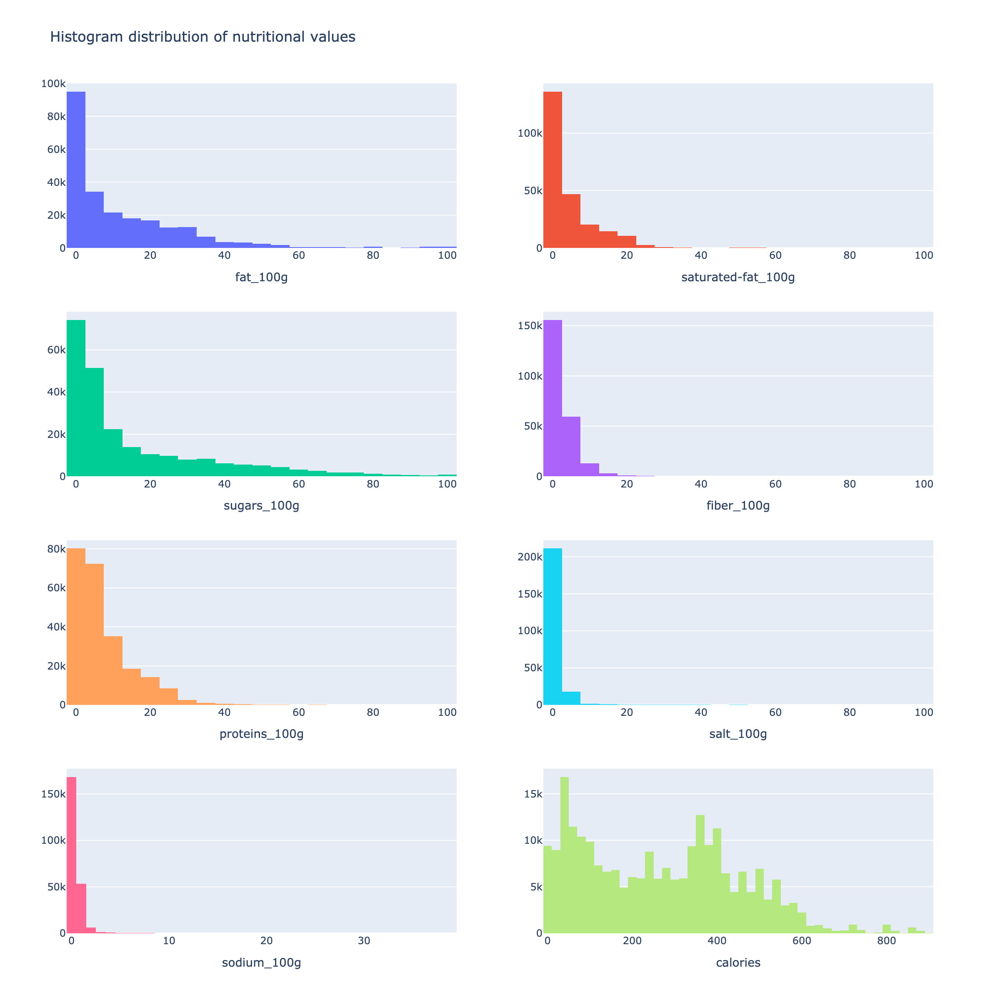

In [54]:
nutritional_vars = ['fat_100g', 'saturated-fat_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g', 'calories']


fig = make_subplots(rows=4, cols=2)

for index, var in enumerate(nutritional_vars):
    fig.add_trace(go.Histogram(x=df[var], nbinsx=50, name=var), row=(index//2)+1, col=(index%2)+1)
    fig.update_xaxes(title_text=var,row=(index//2)+1, col=(index%2)+1)

fig.update_layout(height=1200, width= 1200, showlegend=False, title='Histogram distribution of nutritional values')
pio.write_image(fig, 'charts/nutritional_histograms.png', scale=2)
Image('charts/nutritional_histograms.png')

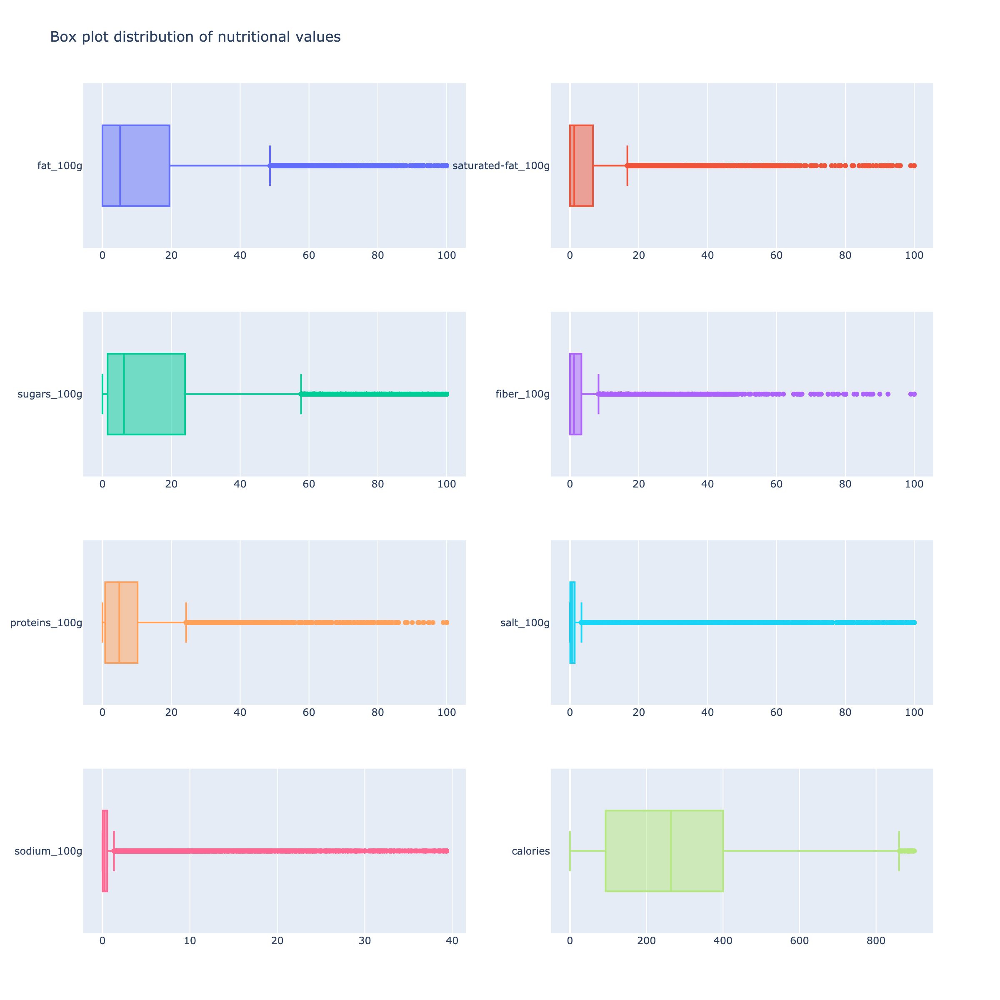

In [55]:
# Distribution  of the nutritional values
fig = make_subplots(rows=4, cols=2)

for index, var in enumerate(nutritional_vars):
    fig.add_trace(go.Box(x=df[var], name=var), row=(index//2)+1, col=(index%2)+1)


fig.update_layout(height=1200, width= 1200, showlegend=False, title='Box plot distribution of nutritional values')
pio.write_image(fig, 'charts/nutritional_boxplots.png', scale=2)
Image('charts/nutritional_boxplots.png')

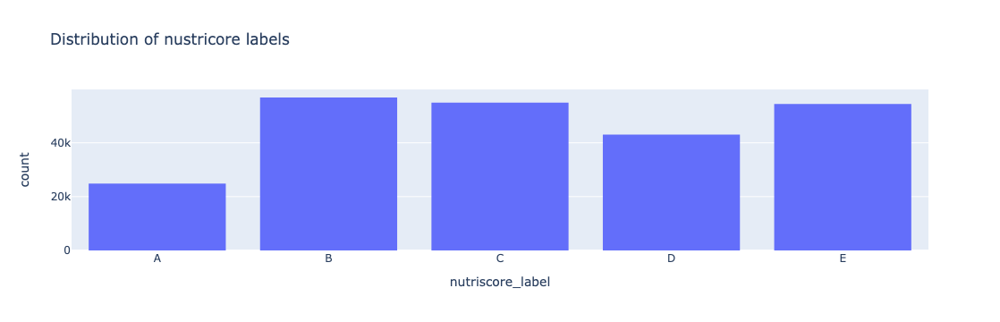

In [56]:
# Distribution of the nutriscore

fig = px.histogram(df.sort_values("nutriscore_label"), x="nutriscore_label", nbins=20, title="Distribution of nustricore labels")
fig.update_layout(autosize=False)
fig.show()

In [57]:
# Distribution of the countries 

country_counts = df['countries_fr'].value_counts()
top_countries = country_counts[:5]
df_pie = df['countries_fr'].apply(lambda x: x if x in top_countries else 'Others')

fig = px.pie(df_pie, names='countries_fr', title="Distribution of product origin per country")
fig.show()

In [58]:
# Variation of new products per month

df.set_index('created_t', inplace=True)
monthly_products = df.resample('Q').size()
monthly_products.index = monthly_products.index.to_period("Q").astype(str)

fig = px.bar(monthly_products, x=monthly_products.index, y=monthly_products.values, title="Distribution of product uploads per quarter")

fig.show()

df.reset_index(inplace=True)

### Bivariate analysis

**Nutriscore evolution over the years**

In [59]:
# Preparing data
df['year'] = df['created_t'].dt.year.astype('str')
mask = (df['nutriscore_label'].isnull() == False)
df_corr = df.loc[mask]

contingency = pd.crosstab(df_corr['nutriscore_label'], df_corr['year'], normalize='columns', margins=True).round(decimals=2)
contingency

year,2012,2013,2014,2015,2016,2017,All
nutriscore_label,,,,,,,
A,0.15,0.16,0.14,0.13,0.12,0.10,0.11
B,0.25,0.24,0.23,0.24,0.23,0.25,0.24
C,0.25,0.25,0.25,0.23,0.24,0.23,0.23
D,0.18,0.17,0.19,0.18,0.19,0.18,0.18
E,0.17,0.18,0.19,0.21,0.22,0.24,0.23


In [60]:
# Plotting the heatmap
px.imshow(pd.crosstab(df_corr['nutriscore_label'], df_corr['year'], normalize='columns').round(decimals=3))

**Correlation between Nutriscore and product origin**

In [61]:
# Preparing data
top_countries = list(df['countries_fr'].value_counts().index[0:10])
df_top_countries = df.loc[df['countries_fr'].isin(top_countries)]
df_top_regions = df_top_countries.copy()
europe = ['France', 'Espagne', 'talie', 'Royaume-Uni', 'Allemagne', 'Suisse', 'Belgique', 'Italie']
df_top_regions.loc[df_top_regions['countries_fr'].isin(europe), 'countries_fr'] = 'Europe'

In [62]:
# ANOVA between countries and nutriscore

groups = []
regions = df_top_regions['countries_fr'].unique().tolist()

for region in regions:
    groups.append(df_top_regions[df_top_regions['countries_fr'] == region]['nutriscore'])

stats.f_oneway(*groups)

F_onewayResult(statistic=155.06819532641856, pvalue=2.086789898149692e-100)

In [63]:
# Plotting the heatmap
px.imshow(pd.crosstab(df_top_regions['countries_fr'], df_top_regions['nutriscore_label'], normalize='index').round(decimals=2))

In [64]:
# Sort countries by median 
df_grouped = df_top_countries.groupby('countries_fr')['nutriscore'].median().reset_index().sort_values(by='nutriscore')
sorted_countries = df_grouped['countries_fr']
df_top_countries['countries_fr'] = pd.Categorical(df_top_countries['countries_fr'], categories=sorted_countries, ordered=True)
df_top_countries = df_top_countries.sort_values('countries_fr')

# Plot the boxes
fig = px.box(df_top_countries, x='countries_fr', y='nutriscore')
fig

**Correlation between calories and product macronutrients**

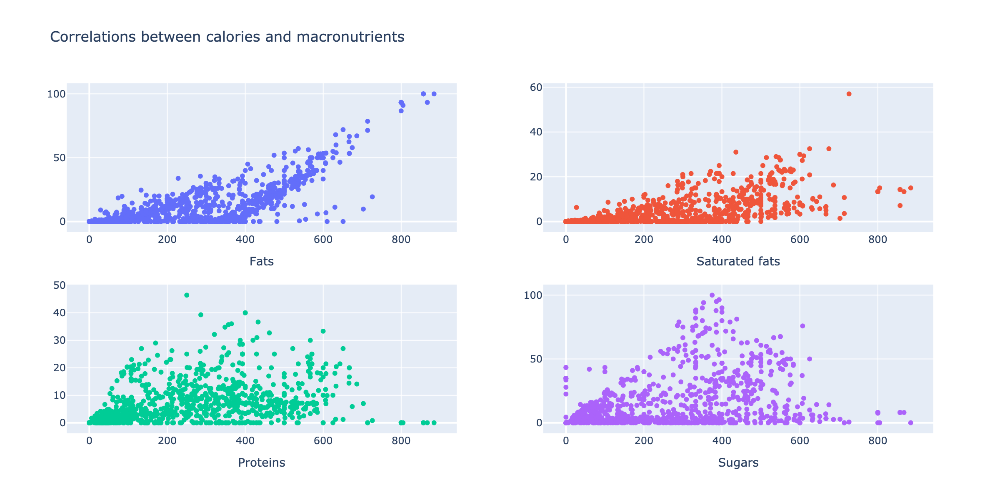

In [65]:
fig = make_subplots(rows=2, cols=2)

df_sample = df.sample(1000)
nutritional_vars = ['fat_100g', 'saturated-fat_100g', 'proteins_100g', 'sugars_100g']
titles = ['Fats', 'Saturated fats', 'Proteins', 'Sugars']

for index, y in enumerate(nutritional_vars):
        fig.add_trace(go.Scatter(x=df_sample['calories'], y=df_sample[y], mode='markers'), row=(index//2)+1, col=(index%2)+1)
        fig.update_xaxes(title_text=titles[index],row=(index//2)+1, col=(index%2)+1)


fig.update_layout(height=600, width= 1200, showlegend=False, title='Correlations between calories and macronutrients')
pio.write_image(fig, 'charts/scatters.png', scale=2)
Image('charts/scatters.png')

### Multivariate analysis

**Principal Component Analysis between different nutritional values**

In [66]:
nutritional_vars = ['fat_100g', 'saturated-fat_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g', 'calories']
df_clusters = df[nutritional_vars]

In [67]:
# Scaling data for PCA
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_clusters)
idx = ["mean", "std"]

pd.DataFrame(X_scaled).describe().round(2).loc[idx, :]

,0,1,2,3,4,5,6,7
mean,-0.0,-0.0,-0.0,0.0,-0.0,0.0,-0.0,0.0
std,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [68]:
# Training PCA
n_components = 6
pca = PCA(n_components=n_components)
pca.fit(X_scaled)

PCA(n_components=6)

In [69]:
explained_var = pca.explained_variance_ratio_

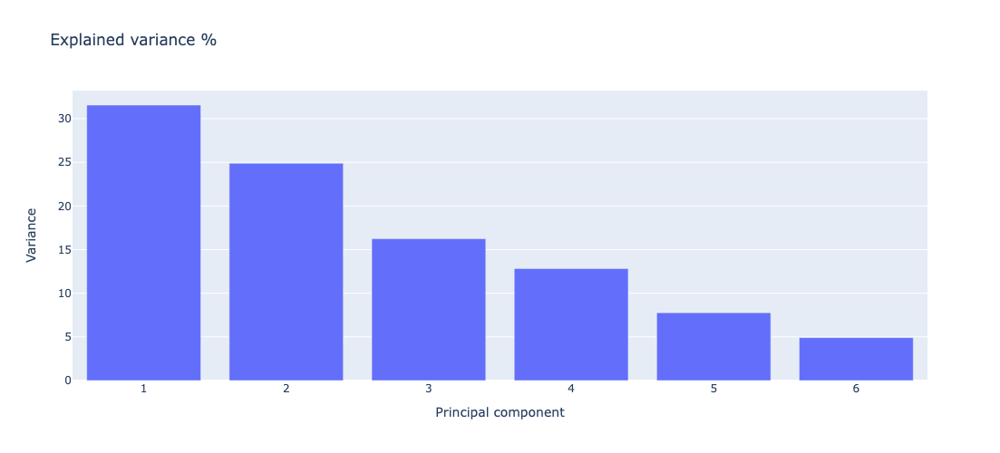

In [70]:
x_list = range(1, n_components+1)
fig = px.bar(x=x_list, y=explained_var * 100, title='Explained variance %')
fig.update_layout(
    autosize=False,
    width=600,
    height=500,
    xaxis_title="Principal component",
    yaxis_title="Variance"
)

fig.show()

In [71]:
# Linear equations of each component 

pcs = pd.DataFrame(pca.components_)
pcs.columns = df_clusters.columns
pcs.index = [f"F{i}" for i in x_list]
pcs.round(2)
pcs

,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,calories
F1,0.544004,0.489372,0.059373,0.178081,0.279060,-0.149368,-0.149388,0.553927
F2,0.126306,0.104380,-0.100907,0.030086,0.138866,0.684015,0.684013,0.083843
F3,-0.038922,-0.150999,-0.705839,0.328208,0.563388,-0.089706,-0.089662,-0.190429
F4,-0.216816,-0.303582,0.433441,0.797823,0.053768,0.041516,0.041516,0.173489
F5,0.281984,0.107090,-0.420747,0.413049,-0.744848,0.006206,0.006245,-0.080635
F6,-0.403818,0.782596,0.109978,0.212343,0.059080,-0.000197,-0.000160,-0.404721


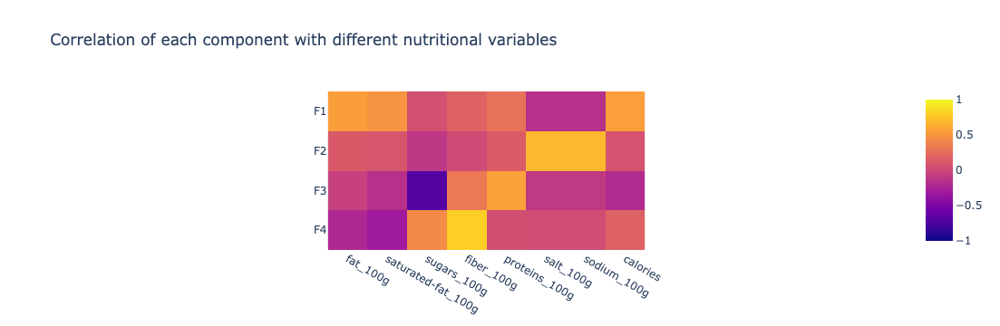

In [72]:
# Correlation graph
px.imshow(pcs[:4],zmin=-1, zmax=1, title="Correlation of each component with different nutritional variables")

**Data points clustering via kmeans**

In [73]:
# Test ideal number of clusters
inertias = []
scaler = MinMaxScaler()
df_clusters = pd.DataFrame(scaler.fit_transform(df_clusters), columns=df_clusters.columns)

for i in range(1, 8):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df_clusters)
    inertias.append(kmeans.inertia_)

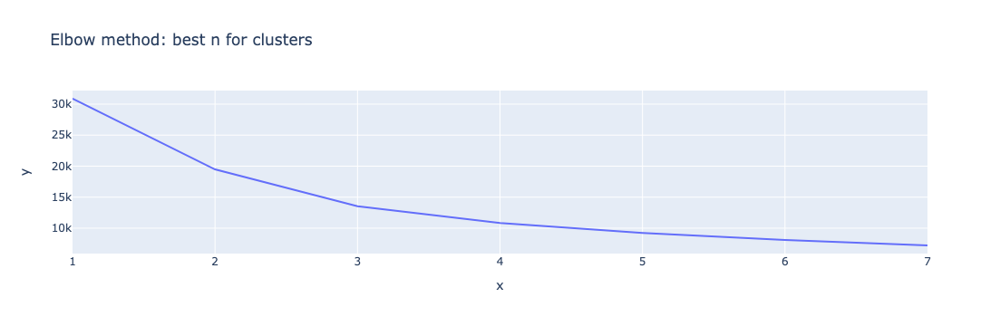

In [74]:
px.line(x=range(1,8), y=inertias, title='Elbow method: best n for clusters')

In [75]:
# Performing kmeans

kmeans = KMeans(n_clusters=3, random_state=42)

kmeans.fit(df_clusters)
df_clusters['cluster'] = kmeans.labels_

In [76]:
df_clusters

,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,calories,cluster
0,0.2100,0.15000,0.2300,0.00000,0.0460,0.001000,0.001000,0.365834,2
1,0.1705,0.11360,0.2500,0.01925,0.0318,0.008000,0.008000,0.302338,1
2,0.2500,0.12625,0.2475,0.03025,0.0900,0.009125,0.009125,0.308980,2
3,0.1480,0.08900,0.2250,0.00300,0.0380,0.001500,0.001500,0.266738,1
4,0.2630,0.16100,0.2230,0.00100,0.0490,0.003000,0.003000,0.409139,2
...,...,...,...,...,...,...,...,...,...
234092,0.0080,0.00300,0.0040,0.00700,0.0180,0.010160,0.010160,0.042242,1
234093,0.2500,0.14000,0.3300,0.05500,0.0700,0.003810,0.003810,0.541977,0
234094,0.0320,0.00900,0.5530,0.01500,0.0760,0.003810,0.003810,0.434910,0
234095,0.1550,0.01300,0.0200,0.03000,0.0850,0.017526,0.017526,0.504251,2


In [77]:
# Grouping clusters

df_grouped_clusters = df_clusters.groupby('cluster').mean()
group_sizes = df_clusters.groupby('cluster').size().reset_index(name='size')
df_grouped_clusters = df_grouped_clusters.reset_index().merge(group_sizes, on='cluster')

In [78]:
# Rename values

df_grouped_clusters = df_grouped_clusters.rename(index={df_grouped_clusters['fat_100g'].idxmax(): 'High fats'})
df_grouped_clusters = df_grouped_clusters.rename(index={df_grouped_clusters['sugars_100g'].idxmax(): 'High sugars'})
df_grouped_clusters = df_grouped_clusters.rename(index={df_grouped_clusters['fat_100g'].idxmin(): 'Low calories'})

In [79]:
df_grouped_clusters

,cluster,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,calories,size
High sugars,0,0.111163,0.058240,0.510442,0.024495,0.041155,0.007076,0.007073,0.437721,45618
Low calories,1,0.043686,0.015652,0.069141,0.020588,0.061318,0.017263,0.017266,0.163944,137991
High fats,2,0.346920,0.116055,0.086013,0.037484,0.127252,0.014562,0.014562,0.538625,50488


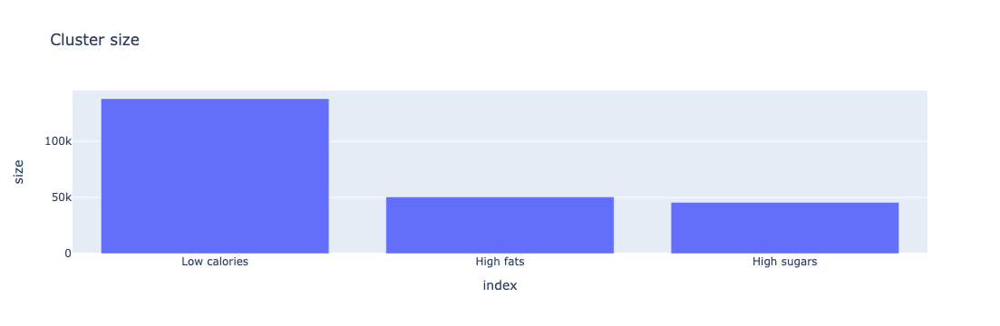

In [80]:
px.bar(df_grouped_clusters.sort_values(by="size", ascending=False), y="size", title="Cluster size").update_layout(autosize=False)

In [81]:
df_grouped_clusters

,cluster,fat_100g,saturated-fat_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,calories,size
High sugars,0,0.111163,0.058240,0.510442,0.024495,0.041155,0.007076,0.007073,0.437721,45618
Low calories,1,0.043686,0.015652,0.069141,0.020588,0.061318,0.017263,0.017266,0.163944,137991
High fats,2,0.346920,0.116055,0.086013,0.037484,0.127252,0.014562,0.014562,0.538625,50488


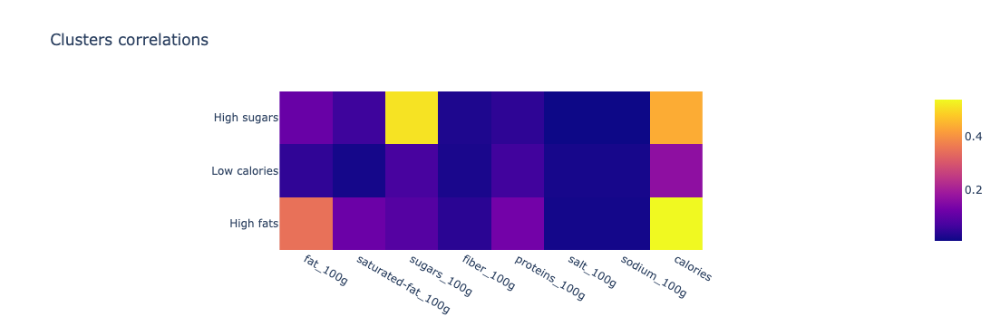

In [82]:
# Plotting heatmap 
df_grouped_clusters = df_grouped_clusters.drop(columns=["size", "cluster"])
fig = px.imshow(df_grouped_clusters, title="Clusters correlations")
fig